In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
pd.set_option('display.max_columns', None)
plt.style.use('ggplot')

In [2]:
mvp_df = pd.read_csv('Cleaned_Data/mvp_filtered_data.csv', index_col=[0])
mvp_input = pd.read_csv('Cleaned_Data/mvp_players_data.csv', index_col=[0])

dpoy_df = pd.read_csv('Cleaned_Data/dpoy_filtered_data.csv', index_col=[0])
dpoy_input = pd.read_csv('Cleaned_Data/dpoy_players_data.csv', index_col=[0])

smoy_df = pd.read_csv('Cleaned_Data/smoy_filtered_data.csv', index_col=[0])
smoy_input = pd.read_csv('Cleaned_Data/smoy_players_data.csv', index_col=[0])

In [3]:
mvp_input['MVP_Winner'] = mvp_input['Rank'].apply(lambda x: "Won" if x == 1 else "Loss")

dpoy_input['DPOY_Winner'] = dpoy_input['Rank'].apply(lambda x: "Won" if x == 1 else "Loss")

smoy_input['SMOY_Winner'] = smoy_input['Rank'].apply(lambda x: "Won" if x == 1 else "Loss")

### Explore correlation and distrubtion of features in MVP dataset
1. Identify features that may have a strong correlation with MVP shares


In [61]:
mvp_train = mvp_input[['Year','Rank', 'Player', 'Tm', 'Share', 'Pos', 'Age', 'G',
       'GS', 'MP', 'FG', 'FGA', 'FG%', '3P', '3PA', '3P%', '2P', '2PA', '2P%',
       'eFG%', 'FT', 'FTA', 'FT%', 'ORB', 'DRB', 'TRB', 'AST', 'STL', 'BLK',
       'TOV', 'PF', 'PTS', 'PER', 'TS%', '3PAr', 'FTr', 'ORB%', 'DRB%', 'TRB%',
       'AST%', 'STL%', 'BLK%', 'TOV%', 'USG%', 'OWS', 'DWS', 'WS', 'WS/48',
       'OBPM', 'DBPM', 'BPM', 'VORP', 'Team_Win_PCT', 'Team_MOV', 'Team_SOS', 
       'Team_SRS', 'Team_ORtg','Team_DRtg', 'Team_NRtg', 'Team_Pace', 'MVP_Winner']].copy()

mvp_test = mvp_df[['Year', 'Player', 'Pos', 'Age', 'Tm', 'G', 'GS', 'MP', 'FG', 'FGA',
       'FG%', '3P', '3PA', '3P%', '2P', '2PA', '2P%', 'eFG%', 'FT', 'FTA',
       'FT%', 'ORB', 'DRB', 'TRB', 'AST', 'STL', 'BLK', 'TOV', 'PF', 'PTS',
       'PER', 'TS%', '3PAr', 'FTr', 'ORB%', 'DRB%', 'TRB%', 'AST%', 'STL%',
       'BLK%', 'TOV%', 'USG%', 'OWS', 'DWS', 'WS', 'WS/48', 'OBPM', 'DBPM',
       'BPM', 'VORP', 'Total_Games', 'Team_W', 'Team_L', 'Team_Win_PCT',
       'Team_MOV', 'Team_SOS', 'Team_SRS', 'Team_ORtg', 'Team_DRtg',
       'Team_NRtg', 'Team_Pace']].copy()

In [84]:
mvp_cor_matrix = mvp_train.corr()


# Let's plot the first 20 features
mvp_top_20_features = list(mvp_cor_matrix[mvp_cor_matrix > .1]['Share'].sort_values(ascending=False).head(20).index)


C:\Users\Nguye\AppData\Local\Temp\ipykernel_6476\3445382022.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  mvp_cor_matrix = mvp_train.corr()


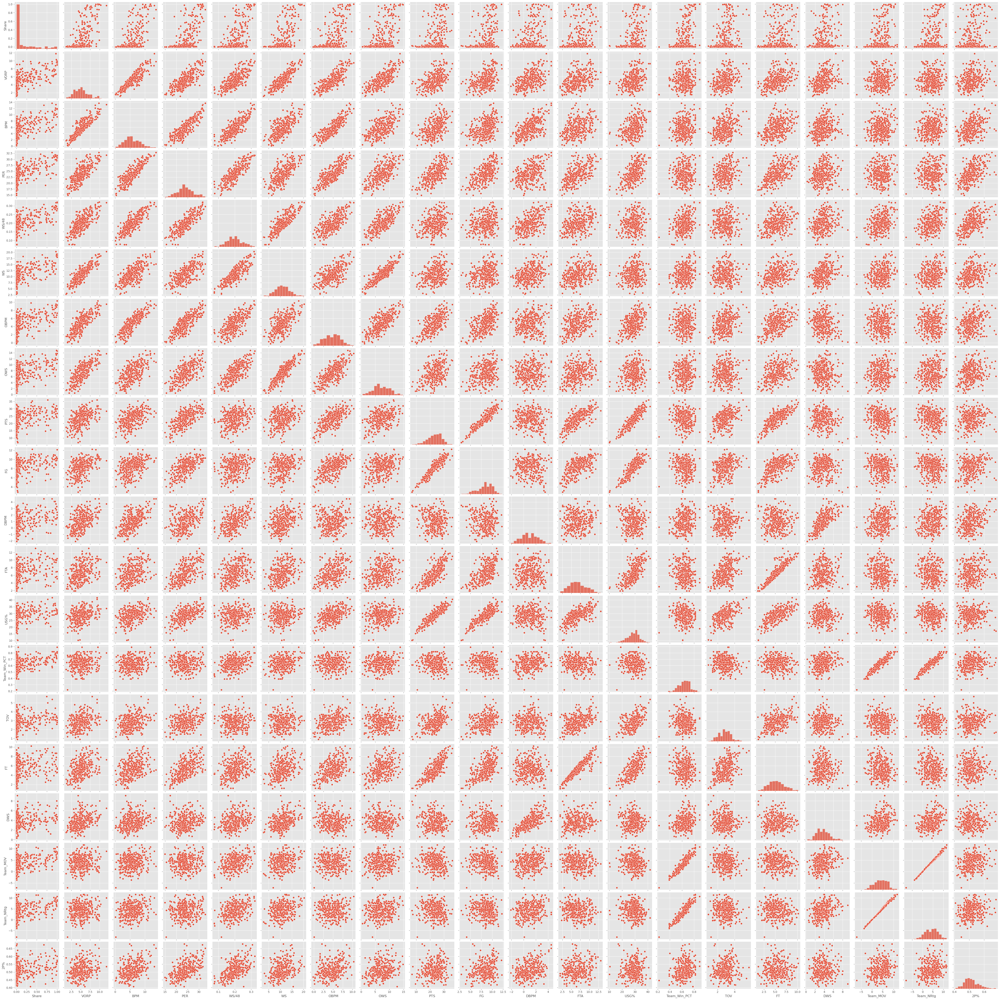

In [30]:
sns.pairplot(mvp_train[mvp_top_20_features])

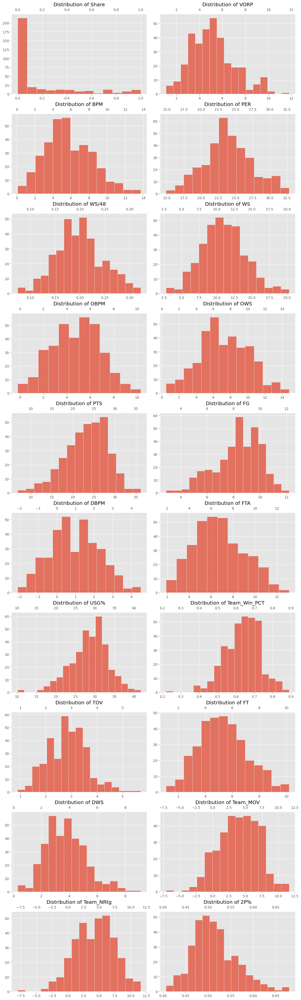

In [85]:
rows = len(mvp_top_20_features)-10
cols = 2
k = 0

fig, axes = plt.subplots(nrows=rows,ncols=cols, figsize=(12,40), constrained_layout = True)
for row in range(rows):
    for col in range(cols):    
        sns.histplot(ax=axes[row,col], data=mvp_train[mvp_top_20_features[k]])
        axes[row,col].title.set_text(f'Distribution of {mvp_top_20_features[k]}')
        axes[row,col].tick_params(labeltop=True)
        axes[row,col].set_xlabel('')
        axes[row,col].set_ylabel('')

        k += 1

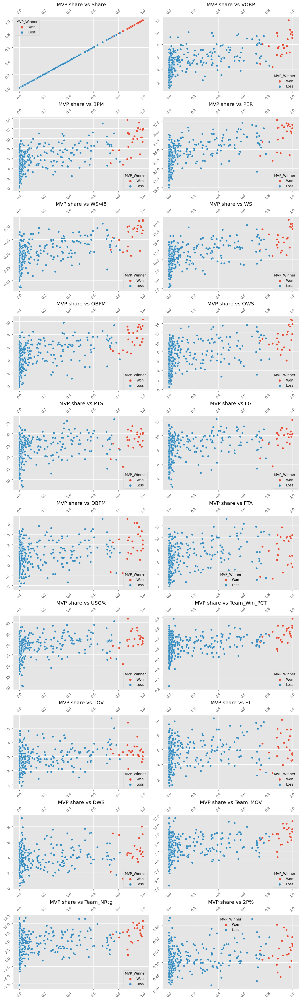

In [39]:
rows = len(mvp_top_20_features)-10
cols = 2
k = 0

fig, axes = plt.subplots(nrows=rows,ncols=cols, figsize=(12,40), constrained_layout = True)
for row in range(rows):
    for col in range(cols):    
        sns.scatterplot(ax=axes[row,col], data=mvp_train, x='Share', y=mvp_top_20_features[k], hue='MVP_Winner')
        axes[row,col].title.set_text(f'MVP share vs {mvp_top_20_features[k]}')
        axes[row,col].tick_params(labeltop=True, labelrotation=45)
        axes[row,col].set_xlabel('')
        axes[row,col].set_ylabel('')

        k += 1

### Explore correlation and distrubtion of features in DPOY dataset
1. Identify features that may have a strong correlation with DPOY shares


In [89]:
dpoy_train = dpoy_input[['Year', 'Rank', 'Player', 'Pos', 'Age', 'Team', 'Tm', 'G', 'GS', 'MP',
       'ORB', 'DRB', 'TRB', 'STL', 'BLK', 'TOV', 'PF', 'PER', 'ORB%', 'DRB%',
       'TRB%', 'STL%', 'BLK%', 'TOV%', 'USG%', 'OWS', 'DWS', 'WS', 'WS/48',
       'OBPM', 'DBPM', 'DRtg', 'BPM', 'VORP', 'Team_Win_PCT', 'Team_MOV', 'Team_SOS', 'Team_SRS',
       'Team_ORtg', 'Team_DRtg', 'Team_NRtg', 'Team_Pace', 'Team_TOV%',
       'Team_ORB%', 'Team_TOV%.1', 'Team_DRB%', 'Share', 'DPOY_Winner']].copy()

dpoy_test = dpoy_df[['Year', 'Player', 'Pos', 'Age', 'Team', 'Tm', 'G', 'GS', 'MP',
       'ORB', 'DRB', 'TRB', 'STL', 'BLK', 'TOV', 'PF', 'PER', 'ORB%', 'DRB%',
       'TRB%', 'STL%', 'BLK%', 'TOV%', 'USG%', 'OWS', 'DWS', 'WS', 'WS/48',
       'OBPM', 'DBPM', 'BPM', 'VORP', 'Team_Win_PCT', 'Team_MOV', 'Team_SOS', 'Team_SRS',
       'Team_ORtg', 'Team_DRtg', 'Team_NRtg', 'Team_Pace', 'Team_TOV%',
       'Team_ORB%', 'Team_TOV%.1', 'Team_DRB%']].copy()

In [55]:
dpoy_cor_matrix = dpoy_train.corr()

dpoy_top_20_features = dpoy_cor_matrix[dpoy_cor_matrix.corr()>.05]['Share'].sort_values(ascending=False).head(20).index

C:\Users\Nguye\AppData\Local\Temp\ipykernel_6476\4107959627.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  dpoy_cor_matrix = dpoy_train.corr()


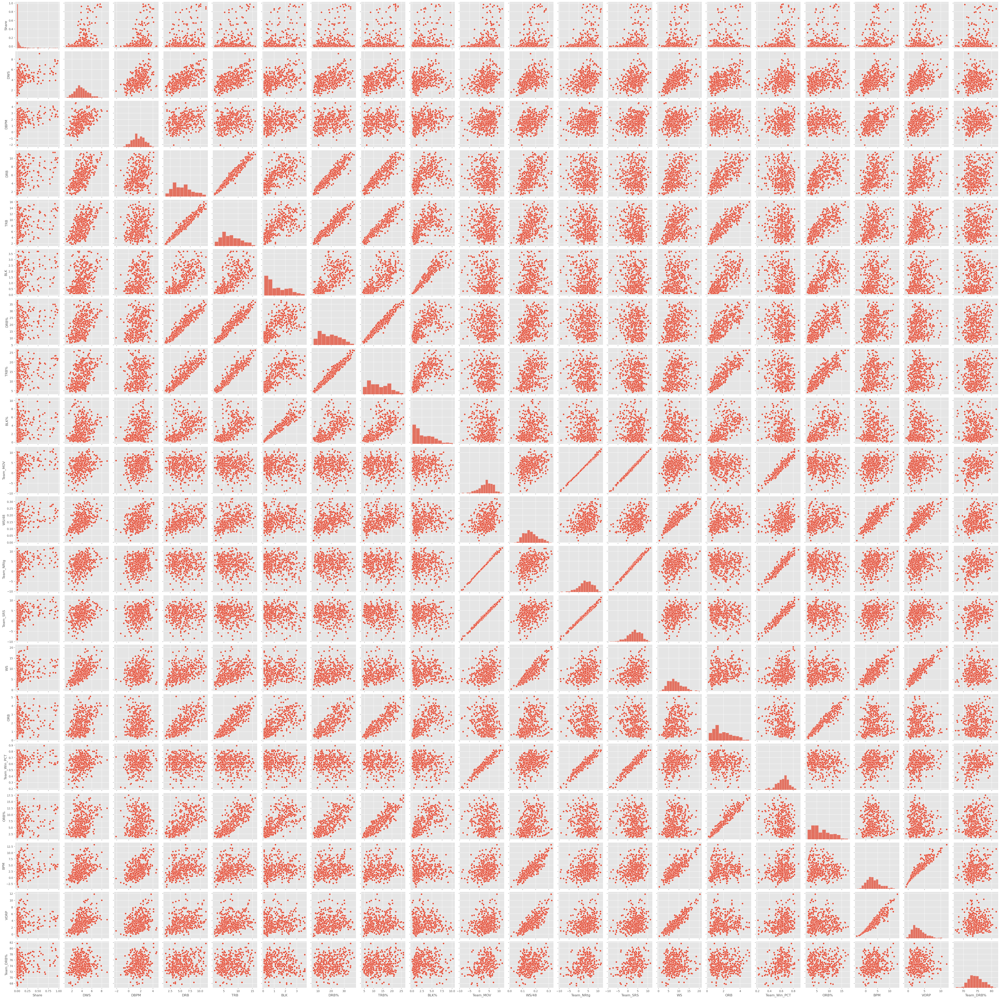

In [56]:
sns.pairplot(dpoy_train[dpoy_top_20_features])

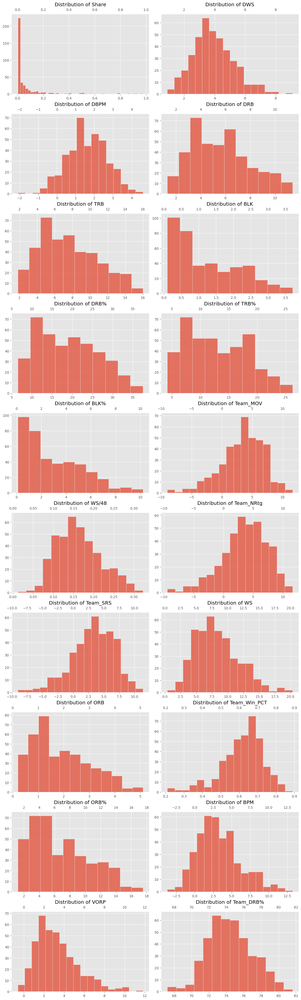

In [82]:
rows = len(dpoy_top_20_features)-10
cols = 2
k = 0

fig, axes = plt.subplots(nrows=rows,ncols=cols, figsize=(12,40), constrained_layout = True)
for row in range(rows):
    for col in range(cols):    
        sns.histplot(ax=axes[row,col], data=dpoy_train[dpoy_top_20_features[k]])
        axes[row,col].title.set_text(f'Distribution of {dpoy_top_20_features[k]}')
        axes[row,col].tick_params(labeltop=True)
        axes[row,col].set_xlabel('')
        axes[row,col].set_ylabel('')

        k += 1

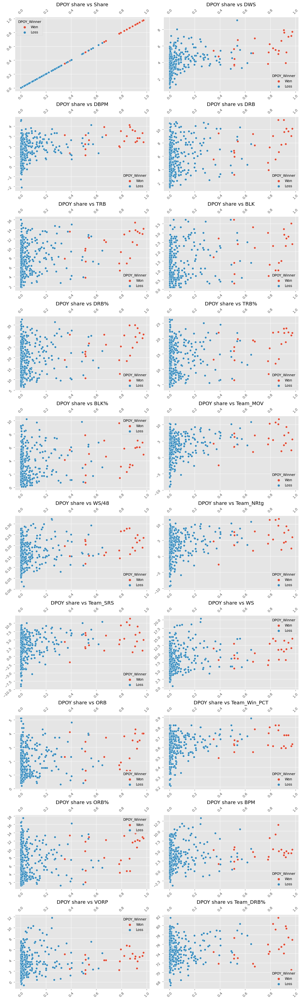

In [66]:
rows = len(dpoy_top_20_features)-10
cols = 2
k = 0

fig, axes = plt.subplots(nrows=rows,ncols=cols, figsize=(12,40), constrained_layout = True)
for row in range(rows):
    for col in range(cols):    
        sns.scatterplot(ax=axes[row,col], data=dpoy_train, x='Share', y=dpoy_top_20_features[k], hue='DPOY_Winner')
        axes[row,col].title.set_text(f'DPOY share vs {dpoy_top_20_features[k]}')
        axes[row,col].tick_params(labeltop=True, labelrotation=45)
        axes[row,col].set_xlabel('')
        axes[row,col].set_ylabel('')

        k += 1

### Explore correlation and distrubtion of features in SMOY dataset
1. Identify features that may have a strong correlation with SMOY shares


In [64]:
smoy_train = smoy_input[['Rank', 'Player', 'Tm', 'Share', 'Year', 'Pos', 'Age', 'Team', 'G',
       'MP', 'FG', 'FGA', 'FG%', '3P', '3PA', '3P%', '2P', '2PA', '2P%',
       'eFG%', 'FT', 'FTA', 'FT%', 'ORB', 'DRB', 'TRB', 'AST', 'STL', 'BLK',
       'TOV', 'PF', 'PTS', 'PER', 'TS%', '3PAr', 'FTr', 'ORB%', 'DRB%', 'TRB%',
       'AST%', 'STL%', 'BLK%', 'TOV%', 'USG%', 'OWS', 'DWS', 'WS', 'WS/48',
       'OBPM', 'DBPM', 'BPM', 'VORP', 'Team_Win_PCT', 'Team_MOV', 'Team_SOS', 'Team_SRS', 'Team_ORtg',
       'Team_DRtg', 'Team_NRtg', 'Team_Pace','SMOY_Winner']].copy()

smoy_test = smoy_df[['Year','Player', 'Tm', 'Pos', 'Age', 'G',
       'MP', 'FG', 'FGA', 'FG%', '3P', '3PA', '3P%', '2P', '2PA', '2P%',
       'eFG%', 'FT', 'FTA', 'FT%', 'ORB', 'DRB', 'TRB', 'AST', 'STL', 'BLK',
       'TOV', 'PF', 'PTS', 'PER', 'TS%', '3PAr', 'FTr', 'ORB%', 'DRB%', 'TRB%',
       'AST%', 'STL%', 'BLK%', 'TOV%', 'USG%', 'OWS', 'DWS', 'WS', 'WS/48',
       'OBPM', 'DBPM', 'BPM', 'VORP', 'Team_Win_PCT', 'Team_MOV', 'Team_SOS', 'Team_SRS', 'Team_ORtg',
       'Team_DRtg', 'Team_NRtg', 'Team_Pace']].copy()

In [71]:
smoy_corr_matrix = smoy_train.corr()

smoy_top_20_features = smoy_corr_matrix[smoy_corr_matrix.corr() > .1]['Share'].sort_values(ascending=False).head(20).index

C:\Users\Nguye\AppData\Local\Temp\ipykernel_6476\3575509201.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  smoy_corr_matrix = smoy_train.corr()


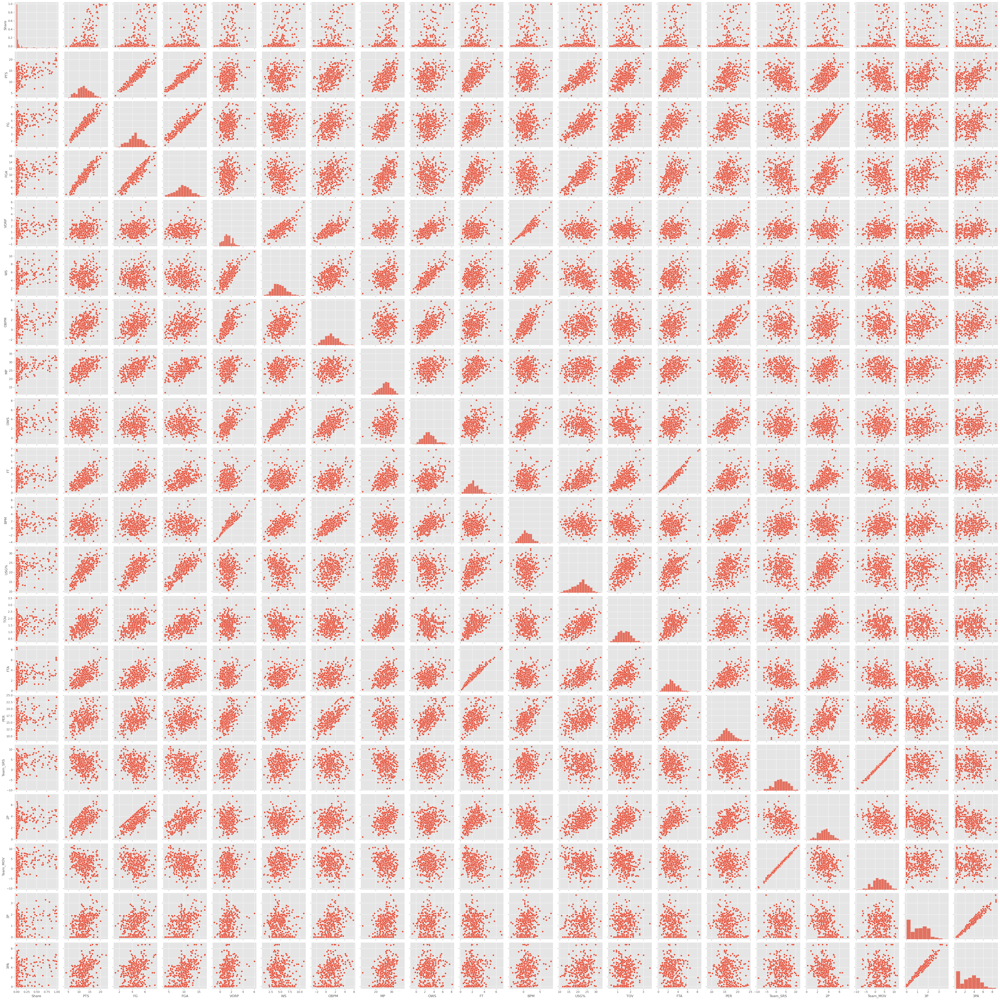

In [75]:
sns.pairplot(smoy_train[smoy_top_20_features])

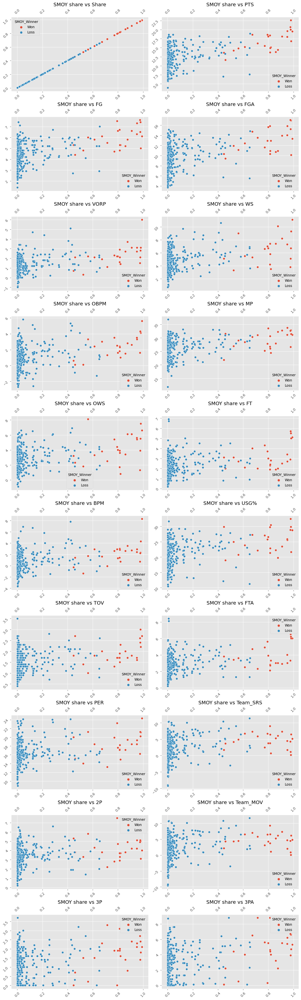

In [76]:
rows = len(smoy_top_20_features)-10
cols = 2
k = 0

fig, axes = plt.subplots(nrows=rows,ncols=cols, figsize=(12,40), constrained_layout = True)
for row in range(rows):
    for col in range(cols):    
        sns.scatterplot(ax=axes[row,col], data=smoy_train, x='Share', y=smoy_top_20_features[k], hue='SMOY_Winner')
        axes[row,col].title.set_text(f'SMOY share vs {smoy_top_20_features[k]}')
        axes[row,col].tick_params(labeltop=True, labelrotation=45)
        axes[row,col].set_xlabel('')
        axes[row,col].set_ylabel('')

        k += 1

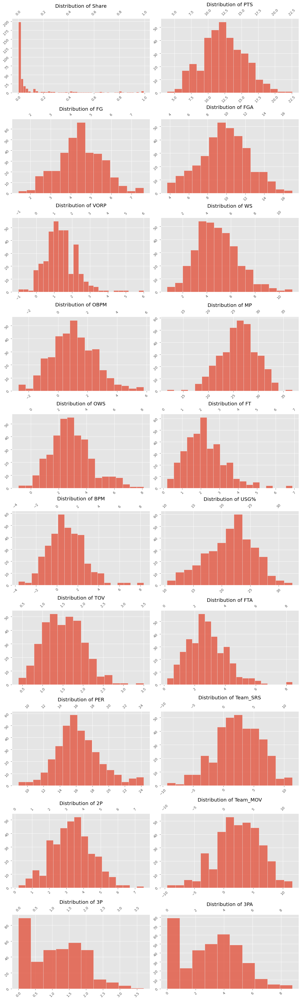

In [81]:
rows = len(smoy_top_20_features)-10
cols = 2
k = 0

fig, axes = plt.subplots(nrows=rows,ncols=cols, figsize=(12,40), constrained_layout = True)
for row in range(rows):
    for col in range(cols):    
        sns.histplot(ax=axes[row,col], data=smoy_train[smoy_top_20_features[k]])
        axes[row,col].title.set_text(f'Distribution of {smoy_top_20_features[k]}')
        axes[row,col].tick_params(labeltop=True, labelrotation=45)
        axes[row,col].set_xlabel('')
        axes[row,col].set_ylabel('')

        k += 1

In [90]:
mvp_train.to_csv('Cleaned_Data/mvp_train.csv')
mvp_test.to_csv('Cleaned_Data/mvp_test.csv')

dpoy_train.to_csv('Cleaned_Data/dpoy_train.csv')
dpoy_test.to_csv('Cleaned_Data/dpoy_test.csv')

smoy_train.to_csv('Cleaned_Data/smoy_train.csv')
smoy_test.to_csv('Cleaned_Data/smoy_test.csv')